# Importing Libraries.

In [17]:
import os
import numpy as np
import pandas as pd

import seaborn as sns
import plotly.express as px 
import matplotlib.pyplot as plt
%matplotlib inline

from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
from sklearn.metrics import euclidean_distances
from scipy.spatial.distance import cdist  

import warnings
warnings.filterwarnings("ignore")

# Reading data

In [18]:
data = pd.read_csv('D:/Downloads/archive (11)/data/data.csv')
genre_data = pd.read_csv('D:/Downloads/archive (11)/data/data_by_genres.csv')
year_data = pd.read_csv('D:/Downloads/archive (11)/data/data_by_year.csv')
artist_data = pd.read_csv('D:/Downloads/archive (11)/data/data_by_artist.csv')

# Performing EDA

In [19]:
print(data.info())
print(genre_data.info())
print(year_data.info())
print(artist_data.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 170653 entries, 0 to 170652
Data columns (total 19 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   valence           170653 non-null  float64
 1   year              170653 non-null  int64  
 2   acousticness      170653 non-null  float64
 3   artists           170653 non-null  object 
 4   danceability      170653 non-null  float64
 5   duration_ms       170653 non-null  int64  
 6   energy            170653 non-null  float64
 7   explicit          170653 non-null  int64  
 8   id                170653 non-null  object 
 9   instrumentalness  170653 non-null  float64
 10  key               170653 non-null  int64  
 11  liveness          170653 non-null  float64
 12  loudness          170653 non-null  float64
 13  mode              170653 non-null  int64  
 14  name              170653 non-null  object 
 15  popularity        170653 non-null  int64  
 16  release_date      17

In [42]:
data

,valence,year,acousticness,artists,danceability,duration_ms,energy,explicit,id,instrumentalness,...,liveness,loudness,mode,name,popularity,release_date,speechiness,tempo,decade,cluster_label
0,0.0594,1921,0.98200,"['Sergei Rachmaninoff', 'James Levine', 'Berli...",0.279,831667,0.211,0,4BJqT0PrAfrxzMOxytFOIz,0.878000,...,0.6650,-20.096,1,"Piano Concerto No. 3 in D Minor, Op. 30: III. ...",4,1921,0.0366,80.954,1920s,7
1,0.9630,1921,0.73200,['Dennis Day'],0.819,180533,0.341,0,7xPhfUan2yNtyFG0cUWkt8,0.000000,...,0.1600,-12.441,1,Clancy Lowered the Boom,5,1921,0.4150,60.936,1920s,6
2,0.0394,1921,0.96100,['KHP Kridhamardawa Karaton Ngayogyakarta Hadi...,0.328,500062,0.166,0,1o6I8BglA6ylDMrIELygv1,0.913000,...,0.1010,-14.850,1,Gati Bali,5,1921,0.0339,110.339,1920s,7
3,0.1650,1921,0.96700,['Frank Parker'],0.275,210000,0.309,0,3ftBPsC5vPBKxYSee08FDH,0.000028,...,0.3810,-9.316,1,Danny Boy,3,1921,0.0354,100.109,1920s,12
4,0.2530,1921,0.95700,['Phil Regan'],0.418,166693,0.193,0,4d6HGyGT8e121BsdKmw9v6,0.000002,...,0.2290,-10.096,1,When Irish Eyes Are Smiling,2,1921,0.0380,101.665,1920s,12
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
170648,0.6080,2020,0.08460,"['Anuel AA', 'Daddy Yankee', 'KAROL G', 'Ozuna...",0.786,301714,0.808,0,0KkIkfsLEJbrcIhYsCL7L5,0.000289,...,0.0822,-3.702,1,China,72,2020-05-29,0.0881,105.029,2020s,18
170649,0.7340,2020,0.20600,['Ashnikko'],0.717,150654,0.753,0,0OStKKAuXlxA0fMH54Qs6E,0.000000,...,0.1010,-6.020,1,Halloweenie III: Seven Days,68,2020-10-23,0.0605,137.936,2020s,18
170650,0.6370,2020,0.10100,['MAMAMOO'],0.634,211280,0.858,0,4BZXVFYCb76Q0Klojq4piV,0.000009,...,0.2580,-2.226,0,AYA,76,2020-11-03,0.0809,91.688,2020s,10
170651,0.1950,2020,0.00998,['Eminem'],0.671,337147,0.623,1,5SiZJoLXp3WOl3J4C8IK0d,0.000008,...,0.6430,-7.161,1,Darkness,70,2020-01-17,0.3080,75.055,2020s,4


In [20]:
data['decade'] = data['year'].apply(lambda year : f'{(year//10)*10}s' )

*The resulting plot shows a bar chart where each bar represents the correlation coefficient between a feature and the target variable (popularity). The key elements to understand are:

Correlation Coefficient: Ranges from -1 to +1. A value of +1 indicates a perfect positive correlation, 0 indicates no correlation, and -1 indicates a perfect negative correlation.
Bar Length: Indicates the strength of the correlation. Longer bars mean stronger correlations.
Bar Direction: Positive correlations have bars extending to the right, while negative correlations extend to the left.
Features and Correlations: This plot helps identify which features have the strongest positive or negative correlations with the target variable, providing insights into which attributes are most associated with song popularity.*

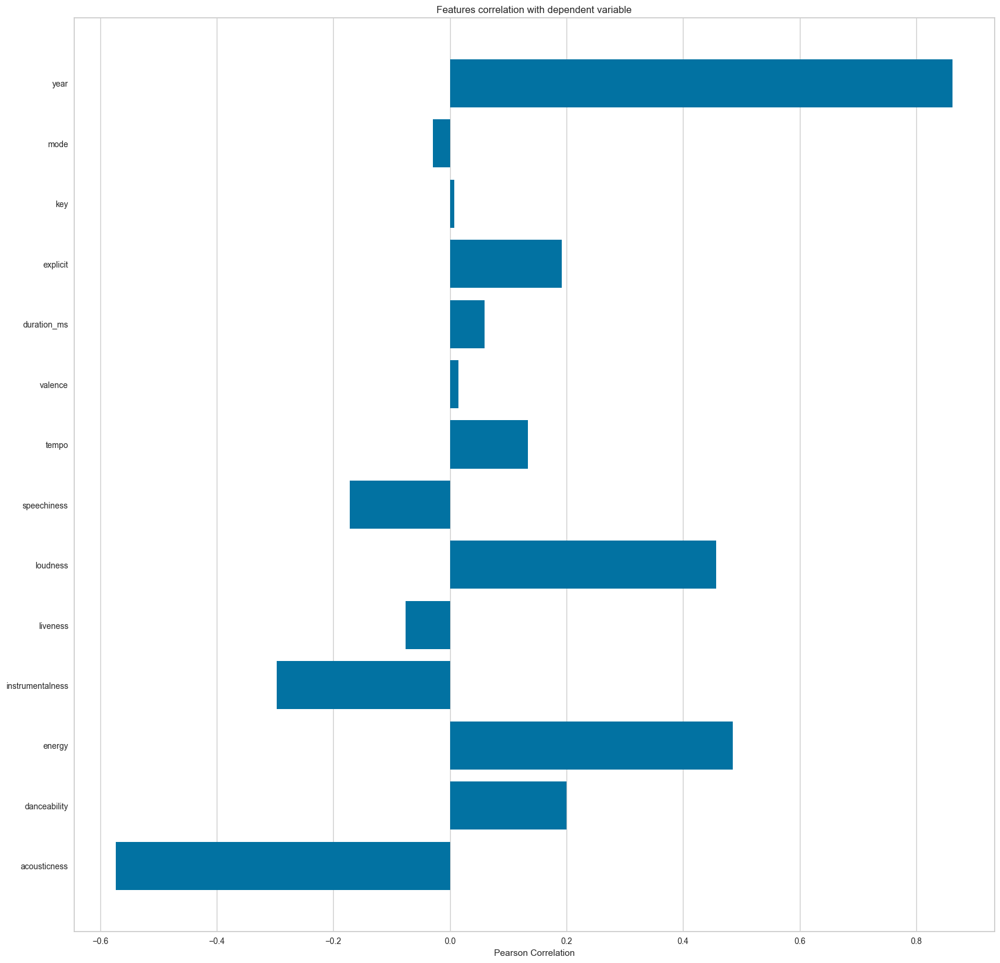

<Axes: title={'center': 'Features correlation with dependent variable'}, xlabel='Pearson Correlation'>

In [21]:
from yellowbrick.target import FeatureCorrelation

feature_names = ['acousticness', 'danceability', 'energy', 'instrumentalness',
       'liveness', 'loudness', 'speechiness', 'tempo', 'valence','duration_ms','explicit','key','mode','year']

X, y = data[feature_names], data['popularity']

# Create a list of the feature names
features = np.array(feature_names)

# Instantiate the visualizer
visualizer = FeatureCorrelation(labels=features)

plt.rcParams['figure.figsize']=(20,20)
visualizer.fit(X, y)     # Fit the data to the visualizer
visualizer.show()

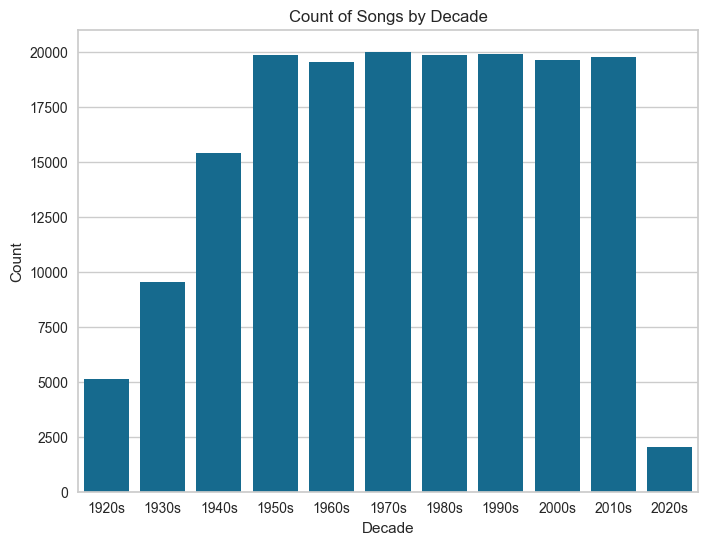

In [22]:
import seaborn as sns
import matplotlib.pyplot as plt

# Corrected count plot for the 'decade' column
plt.figure(figsize=(8, 6))
sns.countplot(x='decade', data=data)  # Explicitly set 'x' to 'decade'
plt.title("Count of Songs by Decade")
plt.xlabel("Decade")
plt.ylabel("Count")
plt.show()


In [23]:
sound_features = ['acousticness', 'danceability', 'energy', 'instrumentalness', 'liveness', 'valence']
fig = px.line(year_data, x='year', y=sound_features)
fig.show()

In [24]:
top10_genres = genre_data.nlargest(10, 'popularity')

fig = px.bar(top10_genres, x='genres', y=['valence', 'energy', 'danceability', 'acousticness'], barmode='group')
fig.show()

# Clustering
 * as similar songs will be in same clusters(close data points)
 * same goes for geners 

In [37]:
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline

cluster_pipeline = Pipeline([('scaler', StandardScaler()), ('kmeans', KMeans(n_clusters=10))])
X = genre_data.select_dtypes(np.number)
cluster_pipeline.fit(X)
genre_data['cluster'] = cluster_pipeline.predict(X)

In [38]:
# Visualizing the Clusters with t-SNE

from sklearn.manifold import TSNE

tsne_pipeline = Pipeline([('scaler', StandardScaler()), ('tsne', TSNE(n_components=2, verbose=1))])
genre_embedding = tsne_pipeline.fit_transform(X)
projection = pd.DataFrame(columns=['x', 'y'], data=genre_embedding)
projection['genres'] = genre_data['genres']
projection['cluster'] = genre_data['cluster']

fig = px.scatter(
    projection, x='x', y='y', color='cluster', hover_data=['x', 'y', 'genres'])
fig.show()

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 2973 samples in 0.003s...
[t-SNE] Computed neighbors for 2973 samples in 0.311s...
[t-SNE] Computed conditional probabilities for sample 1000 / 2973
[t-SNE] Computed conditional probabilities for sample 2000 / 2973
[t-SNE] Computed conditional probabilities for sample 2973 / 2973
[t-SNE] Mean sigma: 0.811370
[t-SNE] KL divergence after 250 iterations with early exaggeration: 71.335159
[t-SNE] KL divergence after 1000 iterations: 1.199600


In [27]:
song_cluster_pipeline = Pipeline([('scaler', StandardScaler()), 
                                  ('kmeans', KMeans(n_clusters=20, 
                                   verbose=False))
                                 ], verbose=False)

X = data.select_dtypes(np.number)
number_cols = list(X.columns)
song_cluster_pipeline.fit(X)
song_cluster_labels = song_cluster_pipeline.predict(X)
data['cluster_label'] = song_cluster_labels

In [28]:
# Visualizing the Clusters with PCA

from sklearn.decomposition import PCA

pca_pipeline = Pipeline([('scaler', StandardScaler()), ('PCA', PCA(n_components=2))])
song_embedding = pca_pipeline.fit_transform(X)
projection = pd.DataFrame(columns=['x', 'y'], data=song_embedding)
projection['title'] = data['name']
projection['cluster'] = data['cluster_label']

fig = px.scatter(
    projection, x='x', y='y', color='cluster', hover_data=['x', 'y', 'title'])
fig.show()

# Spotify API
 * to ge songs to recomand simliar to  the given song
 

In [29]:
import spotipy
from spotipy.oauth2 import SpotifyClientCredentials
from collections import defaultdict
# your_script.py

from spotipy.oauth2 import SpotifyClientCredentials
import spotipy
from collections import defaultdict
from mysecrets import CLIENT_ID, CLIENT_SECRET

sp = spotipy.Spotify(auth_manager=SpotifyClientCredentials(client_id=CLIENT_ID, 
                                                           client_secret=CLIENT_SECRET))


In [30]:
'''
Finds song details from spotify dataset. If song is unavailable in dataset, it returns none.
'''
def find_song(name, year):
    song_data = defaultdict()
    results = sp.search(q= 'track: {} year: {}'.format(name,year), limit=1)
    if results['tracks']['items'] == []:
        return None

    results = results['tracks']['items'][0]
    track_id = results['id']
    audio_features = sp.audio_features(track_id)[0]

    song_data['name'] = [name]
    song_data['year'] = [year]
    song_data['explicit'] = [int(results['explicit'])]
    song_data['duration_ms'] = [results['duration_ms']]
    song_data['popularity'] = [results['popularity']]

    for key, value in audio_features.items():
        song_data[key] = value

    return pd.DataFrame(song_data)
number_cols = ['valence', 'year', 'acousticness', 'danceability', 'duration_ms', 'energy', 'explicit',
 'instrumentalness', 'key', 'liveness', 'loudness', 'mode', 'popularity', 'speechiness', 'tempo']


def get_song_data(song, spotify_data):
    try:
        song_data = spotify_data[(spotify_data['name'] == song['name']) 
                                & (spotify_data['year'] == song['year'])].iloc[0]
        print('Fetching song information from local dataset')
        return song_data
    
    except IndexError:
        print('Fetching song information from spotify dataset')
        return find_song(song['name'], song['year'])
    
'''
Fetches song info from dataset and does the mean of all numerical features of the song-data.
'''
def get_mean_vector(song_list, spotify_data):
    song_vectors = []
    for song in song_list:
        song_data = get_song_data(song, spotify_data)
        if song_data is None:
            print('Warning: {} does not exist in Spotify or in database'.format(song['name']))
            continue
        song_vector = song_data[number_cols].values
        song_vectors.append(song_vector)  
    
    song_matrix = np.array(list(song_vectors))#nd-array where n is number of songs in list. It contains all numerical vals of songs in sep list.
    #print(f'song_matrix {song_matrix}')
    return np.mean(song_matrix, axis=0) # mean of each ele in list, returns 1-d array

def flatten_dict_list(dict_list):
    flattened_dict = defaultdict()
    for key in dict_list[0].keys(): 
        flattened_dict[key] = [] # 'name', 'year'
    for dic in dict_list:
        for key,value in dic.items():
            flattened_dict[key].append(value) # creating list of values
    return flattened_dict

In [31]:
def recommend_songs(song_list, spotify_data, n_songs=10):
    metadata_cols = ['name', 'year', 'artists']
    song_dict = flatten_dict_list(song_list)
    
    # Calculate the mean vector of numerical features for the input songs
    song_center = get_mean_vector(song_list, spotify_data)
    
    # Scale the input mean vector and the dataset numerical features
    scaler = song_cluster_pipeline.steps[0][1]
    scaled_data = scaler.transform(spotify_data[number_cols])
    scaled_song_center = scaler.transform(song_center.reshape(1, -1))
    
    # Calculate cosine distances between the mean input vector and the dataset
    distances = cdist(scaled_song_center, scaled_data, 'cosine')
    
    # Get the indices of the top N songs with maximum similarity
    index = list(np.argsort(distances)[:, :n_songs][0])
    
    # Retrieve the recommended songs from the dataset
    rec_songs = spotify_data.iloc[index]
    
    # Exclude songs that are in the input song list
    rec_songs = rec_songs[~rec_songs['name'].isin(song_dict['name'])]
    
    # Sort recommended songs by their similarity scores (distances)
    rec_songs['similarity_score'] = distances[0][index]
    rec_songs = rec_songs.sort_values(by='similarity_score', ascending=True)
    
    return rec_songs[metadata_cols].to_dict(orient='records')


In [36]:
recommend_songs([{'name': 'Blinding Lights', 'year': 2019}],  data)

Fetching song information from spotify dataset


[{'name': "Victor's Piano Solo", 'year': 2005, 'artists': "['Danny Elfman']"},
 {'name': 'When The Love Falls', 'year': 2001, 'artists': "['Yiruma']"},
 {'name': 'Norrsken', 'year': 2016, 'artists': "['Karin Borg']"},
 {'name': 'The Piano Duet', 'year': 2005, 'artists': "['Danny Elfman']"},
 {'name': 'Moog City 2', 'year': 2013, 'artists': "['C418']"},
 {'name': 'Solêr', 'year': 2014, 'artists': "['Otto Totland']"},
 {'name': 'Great Pumpkin Waltz',
  'year': 1998,
  'artists': "['Vince Guaraldi Trio']"},
 {'name': 'Chopin: Nocturne No. 20 in C-Sharp Minor, Op. Posth.',
  'year': 2000,
  'artists': "['Frédéric Chopin', 'Mikhail Pletnev']"},
 {'name': 'Nocturne in C-Sharp Minor, B. 49',
  'year': 1995,
  'artists': "['Frédéric Chopin', 'Janusz Olejniczak']"},
 {'name': 'The Departure', 'year': 2014, 'artists': "['Max Richter']"}]

We are able to recommend top 10 similar songs to user based on the input. The recommendation is based on similarity of numerical features of the songs. We have calculated the cosine distance and identified the songs with highest similarity. 

i have taken reference of the code from AKERSHI SHUKLA